In [47]:
import pandas as pd
import numpy as np
from glob2 import glob
from tqdm import tqdm
import matplotlib.pyplot as plt
import re
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from collections import Counter
from wordcloud import WordCloud
from nltk.sentiment import SentimentIntensityAnalyzer
from gensim import corpora, models
from itertools import combinations
import math
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import TruncatedSVD
from collections import defaultdict

nltk.download('vader_lexicon')
nltk.download('punkt')
nltk.download('stopwords')


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /home/yhbedoya/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to /home/yhbedoya/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/yhbedoya/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

Read review files and create dataframe

In [2]:
jsonFiles = glob('/home/yhbedoya/Datathon/amazon_reviews/**/*.json.gz')
dfList = []
i = 0
for jsonFile in tqdm(jsonFiles):
    df = pd.read_json(jsonFile, lines=True,compression='gzip')
    dfList.append(df)
    i+=1
    if i >=50:
        break
    
dfAllReviews= pd.concat(dfList, axis=0)
dfAllReviews

 24%|██▎       | 49/208 [00:26<01:26,  1.83it/s]


,asin,overall,reviewText,reviewerID,reviewerName,style,summary,unixReviewTime,verified,image,vote
0,B016EWLE0W,2,"I love the look and quality of this cover, but...",A36I1FITWL1O5V,jb236,"{""Size:"":"" 12-inch MacBook"",""Color:"":"" Rutledg...",Not effective.,1490140800,true,NaN,NaN
1,1883841178,5,"Our book club read this book, and it made for ...",A3LYLX5LYM5UAS,RobertB,"{""Format:"":"" Kindle Edition""}",Great book club selection,1375142400,false,NaN,NaN
2,B016EWLE0W,5,Very pleased with my purchase. Happy customer.,A2XUB342PYLQMZ,Cruzin,"{""Size:"":"" 12-inch MacBook"",""Color:"":"" Rutledg...",Five Stars,1489708800,true,NaN,NaN
3,1883841178,5,This book brought back a flood of emotions and...,A1NLOR85LWBUFZ,J Beattie,"{""Format:"":"" Kindle Edition""}",Wonderful thought provoking subject!,1374278400,false,NaN,NaN
4,B016EWLE0W,2,I don't get it. I ordered the 12 inch cover fo...,A3W47YMIA6I3KO,OMD,"{""Size:"":"" 12-inch MacBook"",""Color:"":"" Rutledg...",Does NOT fit the 2016 Macbook Pro/Retina (with...,1489276800,true,"[""https://images-na.ssl-images-amazon.com/imag...",2.0
...,...,...,...,...,...,...,...,...,...,...,...
55928,B00C4WWM8U,3,"They will work for simple crafting, but I pref...",A3RTWOM0LA5KGH,Frugal shopper,NaN,Colorful,1507334400,true,NaN,NaN
55929,0983920869,5,I just finished reading this book and was very...,AQ87CDLMUJ0PU,Kindle Customer,"{""Format:"":"" Kindle Edition""}",A Good Read!!!!,1355097600,true,NaN,NaN
55930,B00C4WWM8U,5,great for the crafts i use,AK0K0S6FU24EW,Patricia Q,NaN,pretty,1499904000,true,NaN,NaN
55931,0983920869,3,This was just as I reviewed...an OK read. I f...,ASOMJHLRUP9C,Mrs. Marsha Ferrara,"{""Format:"":"" Kindle Edition""}",Predictable,1355011200,true,NaN,NaN


In [3]:
duplicated_rows = dfAllReviews[dfAllReviews.duplicated()]
duplicated_rows

,asin,overall,reviewText,reviewerID,reviewerName,style,summary,unixReviewTime,verified,image,vote
5555,1884550320,5,Fine. Just as advertised.,A1WWTYHS83N3IK,KK,"{""Format:"":"" Paperback""}",Five Stars,1434672000,true,NaN,NaN
5561,1884550320,5,A++++,AO4ETO2PBOWLE,ciba,"{""Format:"":"" Paperback""}",Five Stars,1415318400,true,NaN,NaN
20658,1846288428,5,"Great Book, used for class, very helpful",AM6Y721V2V43L,David,"{""Format:"":"" Paperback""}",Five Stars,1450137600,true,NaN,NaN
33802,1847170692,5,Item as described - quick delivery.,ARZPH7T99S6I6,AKSteve,"{""Format:"":"" Hardcover""}",Five Stars,1430352000,true,NaN,NaN
55161,B00BH9RL64,3,One size fits all was a little too small.,A2J1LBZAC4RQM1,Sonya Bryson-Kirksey,NaN,Three Stars,1468713600,true,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
10419,B0006BN17W,5,"This is a very important, interesting and quit...",A4SY5RCGC5CH9,Darth Maciek,NaN,Memories of one of the greatest soldiers of XX...,1472688000,false,NaN,NaN
17139,B0006C2OJC,5,"The USS PUEBLO, which was captured by the Nort...",A2ARCJ6OYLQPS0,Ervin Parker,NaN,The Pueblo Incident,1187308800,true,"[""https://images-na.ssl-images-amazon.com/imag...",NaN
17141,B0006C2OJC,5,"The USS PUEBLO, which was captured by the Nort...",A2ARCJ6OYLQPS0,Ervin Parker,NaN,The Pueblo Incident,1187308800,true,"[""https://images-na.ssl-images-amazon.com/imag...",NaN
17853,B0006C0GEC,5,"Kochno's book, translated from the French, is ...",A2L7N2U5Z316ZE,Theseus,NaN,An Excellent and Comprehensive Book,1297468800,false,NaN,NaN


In [4]:
dfAllReviews.drop_duplicates(keep='first', inplace=True)
dfAllReviews

,asin,overall,reviewText,reviewerID,reviewerName,style,summary,unixReviewTime,verified,image,vote
0,B016EWLE0W,2,"I love the look and quality of this cover, but...",A36I1FITWL1O5V,jb236,"{""Size:"":"" 12-inch MacBook"",""Color:"":"" Rutledg...",Not effective.,1490140800,true,NaN,NaN
1,1883841178,5,"Our book club read this book, and it made for ...",A3LYLX5LYM5UAS,RobertB,"{""Format:"":"" Kindle Edition""}",Great book club selection,1375142400,false,NaN,NaN
2,B016EWLE0W,5,Very pleased with my purchase. Happy customer.,A2XUB342PYLQMZ,Cruzin,"{""Size:"":"" 12-inch MacBook"",""Color:"":"" Rutledg...",Five Stars,1489708800,true,NaN,NaN
3,1883841178,5,This book brought back a flood of emotions and...,A1NLOR85LWBUFZ,J Beattie,"{""Format:"":"" Kindle Edition""}",Wonderful thought provoking subject!,1374278400,false,NaN,NaN
4,B016EWLE0W,2,I don't get it. I ordered the 12 inch cover fo...,A3W47YMIA6I3KO,OMD,"{""Size:"":"" 12-inch MacBook"",""Color:"":"" Rutledg...",Does NOT fit the 2016 Macbook Pro/Retina (with...,1489276800,true,"[""https://images-na.ssl-images-amazon.com/imag...",2.0
...,...,...,...,...,...,...,...,...,...,...,...
55928,B00C4WWM8U,3,"They will work for simple crafting, but I pref...",A3RTWOM0LA5KGH,Frugal shopper,NaN,Colorful,1507334400,true,NaN,NaN
55929,0983920869,5,I just finished reading this book and was very...,AQ87CDLMUJ0PU,Kindle Customer,"{""Format:"":"" Kindle Edition""}",A Good Read!!!!,1355097600,true,NaN,NaN
55930,B00C4WWM8U,5,great for the crafts i use,AK0K0S6FU24EW,Patricia Q,NaN,pretty,1499904000,true,NaN,NaN
55931,0983920869,3,This was just as I reviewed...an OK read. I f...,ASOMJHLRUP9C,Mrs. Marsha Ferrara,"{""Format:"":"" Kindle Edition""}",Predictable,1355011200,true,NaN,NaN


Read metadata files and create dataframe

In [5]:
jsonFiles = glob('/home/yhbedoya/Datathon/amazon_metadata/**/*.json.gz')
dfList = []
i = 0
for jsonFile in tqdm(jsonFiles):
    df = pd.read_json(jsonFile, lines=True,compression='gzip')
    dfList.append(df)
    i+=1
    if i >=50:
        break
    
dfAllMetadata= pd.concat(dfList, axis=0)
dfAllMetadata

 49%|████▉     | 49/100 [02:19<02:25,  2.85s/it]


,also_buy,also_view,asin,brand,category,date,description,details,feature,fit,image,main_cat,price,rank,similar_item,tech1,tech2,title
0,[],[],B00IJHVUXW,Blackspur,"[Tools & Home Improvement, Hardware, Adhesives...","June 16, 2014",[5.9ml Approx Refresh your tiles with this cle...,{},"[Blackspur grout pen, Refresh your tiles with ...",,[https://images-na.ssl-images-amazon.com/image...,Tools & Home Improvement,,"["">#2,029,407 in Tools & Home Improvement (See...",,"class=""a-keyvalue prodDetTable"" role=""present...",,White Grout Pen Tile Refresher
1,[],[],B00IJHVBFO,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...","February 19, 2014",[Cosmas Hardware is the way to go when designi...,{},"[High Quality Satin Nickel Finish, Hole Center...",,[],Tools & Home Improvement,$2.09,"["">#1,104,604 in Tools & Home Improvement (See...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Cosmas 801-128SN Solid Steel Satin Nickel Arch...
2,"[B00GP422SI, B00HWH775U, B008BKQFN2]","[B00HWH775U, B0721QXDV4, B01M3YRR0L, B008BBUWM...",B00IJHVQS6,Camillus,"[Tools & Home Improvement, Power & Hand Tools,...",,[The Camillus Les Stroud S.K. Path Fixed Saw f...,{' Product Dimensions: ': '16.5 x 2.2...,"[Camillus Les Stroud SK Collection, Carbonitri...",,[https://images-na.ssl-images-amazon.com/image...,Sports & Outdoors,,"649,493 in Sports & Outdoors (",,,,Camillus Knives Les Stroud S.K. Path Fixed Bla...
3,[],[],B00IJI10BI,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...","February 19, 2014",[Cosmas Hardware is the way to go when designi...,{},"[High Quality Satin Nickel Finish, Hole Center...",,[],Tools & Home Improvement,$37.95,"["">#529,778 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Cosmas 801-96SN Solid Steel Satin Nickel Arch ...
4,[],[],B00IJI11XK,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...","February 19, 2014",[Cosmas Hardware is the way to go when designi...,{},"[High Quality Satin Nickel Finish, Hole Center...",,[],Tools & Home Improvement,$47.25,"["">#682,746 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Cosmas 801-128SN Solid Steel Satin Nickel Arch...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,[],[],B00GLA2D4E,ADS,"[Tools & Home Improvement, Paint, Wall Treatme...",,"[Size: 4.0"" --- Color: White --- This decal is...",{},[This decal is made with high performance viny...,,[],Amazon Home,,"["">#3,650,799 in Home & Kitchen (See Top 100 i...",,,,I Love My Pitbull Dog 4&quot; White Vinyl Deca...
9996,[],"[B00FYXTQZS, B00N775PDU, B07CPPJG2M, B018BBOR0...",B00GL9SPB0,Amora Lighting,"[Tools & Home Improvement, Lighting & Ceiling ...","November 10, 2013",[Dimensions Diameter 16 Inch Electrical cord 5...,{},"[No Fabrics, Imported, Glass pieces 90 Cabocho...",,[],Tools & Home Improvement,,"["">#921,853 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Amora Lighting AM1042HL16 Tiffany Style Cascad...
9997,[],[],B00GLA2MWM,Convectair,"[Tools & Home Improvement, Building Supplies, ...","December 7, 2016",[The Convectair 7359-C05-BB Apero 240 Volt Whi...,{},[The Convectair 7359-C05-BB Apero features qui...,,[],Tools & Home Improvement,$239.30,"["">#561,254 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Convectair Apero 240v 500w Heater
9998,[],"[B00Y7ZB1XO, B009ETPBJI, B0099PAWPU, B00Y7Y46K...",B00GLA9DNI,CIP,"[Tools & Home Improvement, Lighting & Ceiling ...",,[These Extension Cords are a great solution fo...,{},"[6.5ft Extension Cord, Mini 2Pin Plug and Play...",,[https://images-na.ssl-images-amazon.com/image...,Amazon Home,$11.99,"["">#435,960

In [6]:
subset_columns = ['asin', "brand", "main_cat", "price", 'title']
dfAllMetadata.drop_duplicates(keep='first', inplace=True, subset=subset_columns)
dfAllMetadata

,also_buy,also_view,asin,brand,category,date,description,details,feature,fit,image,main_cat,price,rank,similar_item,tech1,tech2,title
0,[],[],B00IJHVUXW,Blackspur,"[Tools & Home Improvement, Hardware, Adhesives...","June 16, 2014",[5.9ml Approx Refresh your tiles with this cle...,{},"[Blackspur grout pen, Refresh your tiles with ...",,[https://images-na.ssl-images-amazon.com/image...,Tools & Home Improvement,,"["">#2,029,407 in Tools & Home Improvement (See...",,"class=""a-keyvalue prodDetTable"" role=""present...",,White Grout Pen Tile Refresher
1,[],[],B00IJHVBFO,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...","February 19, 2014",[Cosmas Hardware is the way to go when designi...,{},"[High Quality Satin Nickel Finish, Hole Center...",,[],Tools & Home Improvement,$2.09,"["">#1,104,604 in Tools & Home Improvement (See...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Cosmas 801-128SN Solid Steel Satin Nickel Arch...
2,"[B00GP422SI, B00HWH775U, B008BKQFN2]","[B00HWH775U, B0721QXDV4, B01M3YRR0L, B008BBUWM...",B00IJHVQS6,Camillus,"[Tools & Home Improvement, Power & Hand Tools,...",,[The Camillus Les Stroud S.K. Path Fixed Saw f...,{' Product Dimensions: ': '16.5 x 2.2...,"[Camillus Les Stroud SK Collection, Carbonitri...",,[https://images-na.ssl-images-amazon.com/image...,Sports & Outdoors,,"649,493 in Sports & Outdoors (",,,,Camillus Knives Les Stroud S.K. Path Fixed Bla...
3,[],[],B00IJI10BI,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...","February 19, 2014",[Cosmas Hardware is the way to go when designi...,{},"[High Quality Satin Nickel Finish, Hole Center...",,[],Tools & Home Improvement,$37.95,"["">#529,778 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Cosmas 801-96SN Solid Steel Satin Nickel Arch ...
4,[],[],B00IJI11XK,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...","February 19, 2014",[Cosmas Hardware is the way to go when designi...,{},"[High Quality Satin Nickel Finish, Hole Center...",,[],Tools & Home Improvement,$47.25,"["">#682,746 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Cosmas 801-128SN Solid Steel Satin Nickel Arch...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,[],[],B00GLA2D4E,ADS,"[Tools & Home Improvement, Paint, Wall Treatme...",,"[Size: 4.0"" --- Color: White --- This decal is...",{},[This decal is made with high performance viny...,,[],Amazon Home,,"["">#3,650,799 in Home & Kitchen (See Top 100 i...",,,,I Love My Pitbull Dog 4&quot; White Vinyl Deca...
9996,[],"[B00FYXTQZS, B00N775PDU, B07CPPJG2M, B018BBOR0...",B00GL9SPB0,Amora Lighting,"[Tools & Home Improvement, Lighting & Ceiling ...","November 10, 2013",[Dimensions Diameter 16 Inch Electrical cord 5...,{},"[No Fabrics, Imported, Glass pieces 90 Cabocho...",,[],Tools & Home Improvement,,"["">#921,853 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Amora Lighting AM1042HL16 Tiffany Style Cascad...
9997,[],[],B00GLA2MWM,Convectair,"[Tools & Home Improvement, Building Supplies, ...","December 7, 2016",[The Convectair 7359-C05-BB Apero 240 Volt Whi...,{},[The Convectair 7359-C05-BB Apero features qui...,,[],Tools & Home Improvement,$239.30,"["">#561,254 in Tools & Home Improvement (See t...","class=""a-bordered a-horizontal-stripes a-spa...","class=""a-keyvalue prodDetTable"" role=""present...",,Convectair Apero 240v 500w Heater
9998,[],"[B00Y7ZB1XO, B009ETPBJI, B0099PAWPU, B00Y7Y46K...",B00GLA9DNI,CIP,"[Tools & Home Improvement, Lighting & Ceiling ...",,[These Extension Cords are a great solution fo...,{},"[6.5ft Extension Cord, Mini 2Pin Plug and Play...",,[https://images-na.ssl-images-amazon.com/image...,Amazon Home,$11.99,"["">#435,960

Review text

In [7]:
for i in range(10):
    print(f"---------------------------------------------------Review {i} -------------------------------------------------------------")
    print(dfAllReviews["reviewText"].iloc[i])
    print(dfAllReviews["summary"].iloc[i])
    print("\n")

---------------------------------------------------Review 0 -------------------------------------------------------------
I love the look and quality of this cover, but my computer does not stay in the case. The $20 knock-off case I got holds my computer much more securely. I had this case for a larger macbook and it seemed to work better. This computer is too light to stay in the case. I returned it.
Not effective.


---------------------------------------------------Review 1 -------------------------------------------------------------
Our book club read this book, and it made for a wonderful discussion.  Topics brought up included how attitudes have changed regarding teenage pregnancy, what it's like to put a baby up for adoption,  and how Judy's family treated her pregnancy, to name just a few.  I'm sure your group will find lots to talk about as well.
Great book club selection


---------------------------------------------------Review 2 -------------------------------------------

In [8]:
dfAllReviews = dfAllReviews[["asin", "overall", "reviewText", "reviewerID", "summary", "verified"]]
dfAllReviews

,asin,overall,reviewText,reviewerID,summary,verified
0,B016EWLE0W,2,"I love the look and quality of this cover, but...",A36I1FITWL1O5V,Not effective.,true
1,1883841178,5,"Our book club read this book, and it made for ...",A3LYLX5LYM5UAS,Great book club selection,false
2,B016EWLE0W,5,Very pleased with my purchase. Happy customer.,A2XUB342PYLQMZ,Five Stars,true
3,1883841178,5,This book brought back a flood of emotions and...,A1NLOR85LWBUFZ,Wonderful thought provoking subject!,false
4,B016EWLE0W,2,I don't get it. I ordered the 12 inch cover fo...,A3W47YMIA6I3KO,Does NOT fit the 2016 Macbook Pro/Retina (with...,true
...,...,...,...,...,...,...
55928,B00C4WWM8U,3,"They will work for simple crafting, but I pref...",A3RTWOM0LA5KGH,Colorful,true
55929,0983920869,5,I just finished reading this book and was very...,AQ87CDLMUJ0PU,A Good Read!!!!,true
55930,B00C4WWM8U,5,great for the crafts i use,AK0K0S6FU24EW,pretty,true
55931,0983920869,3,This was just as I reviewed...an OK read. I f...,ASOMJHLRUP9C,Predictable,true


In [10]:
dfAllReviews["verified"].value_counts()

verified
true     1003023
false     283250
Name: count, dtype: int64

ReviewerID analysis

In [11]:
column_counts = dfAllReviews['reviewerID'].value_counts()
column_counts

reviewerID
A34ZM36508LG9G    219
AN3MHNH3C8FJE     200
A20DHMP2YXRGLC    185
A13DYGE3A6IQR0    175
A2OJW07GQRNJUT    173
                 ... 
A2E9IC8HAGA60       1
A2QCMJUNMLI3QE      1
A3HT87CCWGXMN7      1
A1TIXX13HHCZ1H      1
A22Y94LCADBKW5      1
Name: count, Length: 1081489, dtype: int64

In [12]:
unique_values = column_counts.index
counts = column_counts.values

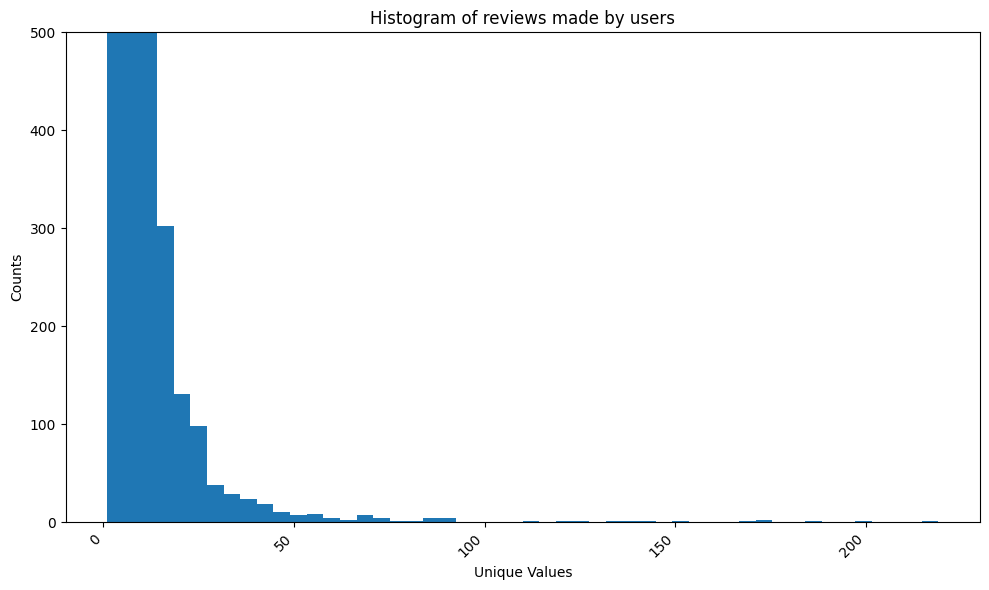

In [13]:
# Create the histogram
plt.figure(figsize=(10, 6))
plt.hist(counts, bins=50)

# Add labels and title
plt.xlabel('Unique Values')
plt.ylabel('Counts')
plt.title('Histogram of reviews made by users')

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Set the limit on the y-axis
plt.ylim(top=500)

# Show the plot
plt.tight_layout()
plt.show()

In [14]:
dfAllMetadata = dfAllMetadata[["also_buy", "also_view", "asin", "brand", "category", "description", "feature", "main_cat", "price", "title"]]
dfAllMetadata

,also_buy,also_view,asin,brand,category,description,feature,main_cat,price,title
0,[],[],B00IJHVUXW,Blackspur,"[Tools & Home Improvement, Hardware, Adhesives...",[5.9ml Approx Refresh your tiles with this cle...,"[Blackspur grout pen, Refresh your tiles with ...",Tools & Home Improvement,,White Grout Pen Tile Refresher
1,[],[],B00IJHVBFO,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...",[Cosmas Hardware is the way to go when designi...,"[High Quality Satin Nickel Finish, Hole Center...",Tools & Home Improvement,$2.09,Cosmas 801-128SN Solid Steel Satin Nickel Arch...
2,"[B00GP422SI, B00HWH775U, B008BKQFN2]","[B00HWH775U, B0721QXDV4, B01M3YRR0L, B008BBUWM...",B00IJHVQS6,Camillus,"[Tools & Home Improvement, Power & Hand Tools,...",[The Camillus Les Stroud S.K. Path Fixed Saw f...,"[Camillus Les Stroud SK Collection, Carbonitri...",Sports & Outdoors,,Camillus Knives Les Stroud S.K. Path Fixed Bla...
3,[],[],B00IJI10BI,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...",[Cosmas Hardware is the way to go when designi...,"[High Quality Satin Nickel Finish, Hole Center...",Tools & Home Improvement,$37.95,Cosmas 801-96SN Solid Steel Satin Nickel Arch ...
4,[],[],B00IJI11XK,Cosmas,"[Tools & Home Improvement, Hardware, Cabinet H...",[Cosmas Hardware is the way to go when designi...,"[High Quality Satin Nickel Finish, Hole Center...",Tools & Home Improvement,$47.25,Cosmas 801-128SN Solid Steel Satin Nickel Arch...
...,...,...,...,...,...,...,...,...,...,...
9995,[],[],B00GLA2D4E,ADS,"[Tools & Home Improvement, Paint, Wall Treatme...","[Size: 4.0"" --- Color: White --- This decal is...",[This decal is made with high performance viny...,Amazon Home,,I Love My Pitbull Dog 4&quot; White Vinyl Deca...
9996,[],"[B00FYXTQZS, B00N775PDU, B07CPPJG2M, B018BBOR0...",B00GL9SPB0,Amora Lighting,"[Tools & Home Improvement, Lighting & Ceiling ...",[Dimensions Diameter 16 Inch Electrical cord 5...,"[No Fabrics, Imported, Glass pieces 90 Cabocho...",Tools & Home Improvement,,Amora Lighting AM1042HL16 Tiffany Style Cascad...
9997,[],[],B00GLA2MWM,Convectair,"[Tools & Home Improvement, Building Supplies, ...",[The Convectair 7359-C05-BB Apero 240 Volt Whi...,[The Convectair 7359-C05-BB Apero features qui...,Tools & Home Improvement,$239.30,Convectair Apero 240v 500w Heater
9998,[],"[B00Y7ZB1XO, B009ETPBJI, B0099PAWPU, B00Y7Y46K...",B00GLA9DNI,CIP,"[Tools & Home Improvement, Lighting & Ceiling ...",[These Extension Cords are a great solution fo...,"[6.5ft Extension Cord, Mini 2Pin Plug and Play...",Amazon Home,$11.99,Mini 2Pin Plug and Play Outdoor Landscape Deck...


In [15]:
dfAll = pd.merge(dfAllReviews, dfAllMetadata, on='asin', how='inner')
dfAll

,asin,overall,reviewText,reviewerID,summary,verified,also_buy,also_view,brand,category,description,feature,main_cat,price,title
0,B00FHCKIWQ,5,It fits my daughter as a royal princess; absol...,A1MI2XGVEWGN7W,Royal look,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...
1,B00FHCKIWQ,5,My baby loved this dress. Wore it for a weddi...,A24EGC2ORSXPST,My baby loved this dress,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...
2,B00FHCKIWQ,5,Now I must admit I am very hesitant on purchas...,ATB6TEHIQUN5F,Perfect flower girl dress!,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...
3,B00FHCKIWQ,5,Bought this for my daughter. Fit was wonderful...,A1C1CHJ9FUKJ4V,Fit was wonderful. Quality was so much better ...,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...
4,B00FHCKIWQ,5,It was even prettier than expected. I was more...,A2QBFYNI78AX22,Absolutely Adorable :),true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30786,B00BHVICZG,4,smaller than I thought,A3AAKDVPOWQFMO,Four Stars,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na..."
30787,B00BHVICZG,4,Way too small for water for any more than a bi...,AHKNLRAR8FX2J,Perfect calcium cup,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na..."
30788,B00BHVICZG,1,it rusted terrible will not buy again,A7604PHY9RB95,One Star,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na..."
30789,B00BHVICZG,5,These work great for feeding my chickens their...,AUMHSACJLDJD8,Great for grit and oyster shell.,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na..."


Analisys by brand

In [79]:
# Assuming you have a DataFrame called df and the column name is 'column_name'
column_counts = dfAll['brand'].value_counts()
# Get the unique values and their corresponding counts from the value_counts() result
unique_values = column_counts.index
counts = column_counts.values

In [80]:
column_counts

brand
Arm & Hammer        3229
Blueberry Pet       2153
GoDoggie-GLOW       1897
Purina Tidy Cats    1561
Wahl                1354
                    ... 
Multi Pet              1
Grriggles              1
Shop-Rama              1
Hayward                1
CNATTAGS               1
Name: count, Length: 289, dtype: int64

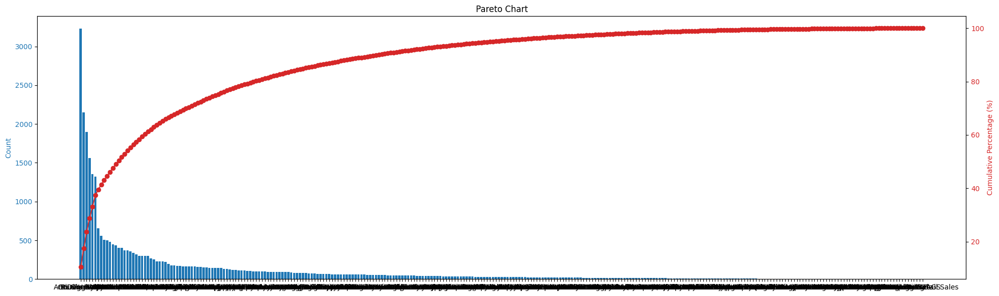

In [81]:
# Sort the Series in descending order
sorted_series = column_counts.sort_values(ascending=False)

# Calculate the cumulative percentage
cumulative_percentage = (sorted_series.cumsum() / sorted_series.sum()) * 100

# Create the Pareto chart
fig, ax1 = plt.subplots(figsize=(20, 6))

# Bar chart for the count
ax1.bar(sorted_series.index, sorted_series, color='tab:blue')
ax1.set_ylabel('Count', color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')

# Line chart for the cumulative percentage
ax2 = ax1.twinx()
ax2.plot(sorted_series.index, cumulative_percentage, marker='o', color='tab:red')
ax2.set_ylabel('Cumulative Percentage (%)', color='tab:red')
ax2.tick_params(axis='y', labelcolor='tab:red')

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

# Title and labels
plt.title('Pareto Chart')
plt.xlabel('Brand')

# Display the chart
plt.tight_layout()
plt.show()

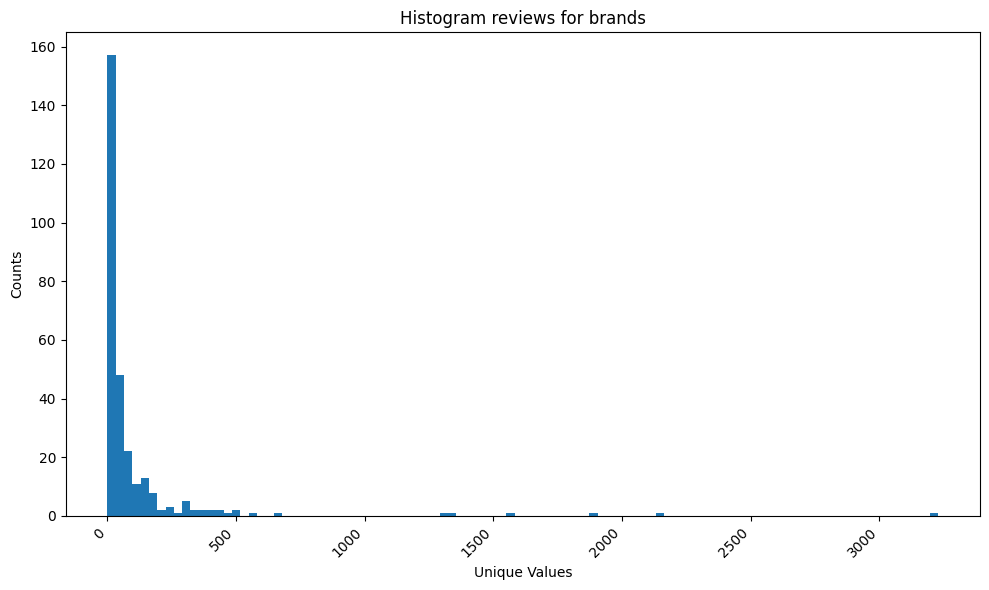

In [25]:
# Create the histogram
plt.figure(figsize=(10, 6))
plt.hist(counts, bins=100)

# Add labels and title
plt.xlabel('Unique Values')
plt.ylabel('Counts')
plt.title('Histogram reviews for brands')

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.tight_layout()
plt.show()

Drop urls or html pieces

In [61]:
reviewText = dfAll["reviewText"].astype(str)
clean_reviews = reviewText.apply(lambda text: re.sub(r'<a.*?>.*?</a>', '', text))
clean_reviews = clean_reviews.str.lower()
dfAll["cleanReviewText"] = clean_reviews
dfAll

,asin,overall,reviewText,reviewerID,summary,verified,also_buy,also_view,brand,category,description,feature,main_cat,price,title,cleanReviewText
0,B00FHCKIWQ,5,It fits my daughter as a royal princess; absol...,A1MI2XGVEWGN7W,Royal look,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,it fits my daughter as a royal princess; absol...
1,B00FHCKIWQ,5,My baby loved this dress. Wore it for a weddi...,A24EGC2ORSXPST,My baby loved this dress,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,my baby loved this dress. wore it for a weddi...
2,B00FHCKIWQ,5,Now I must admit I am very hesitant on purchas...,ATB6TEHIQUN5F,Perfect flower girl dress!,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,now i must admit i am very hesitant on purchas...
3,B00FHCKIWQ,5,Bought this for my daughter. Fit was wonderful...,A1C1CHJ9FUKJ4V,Fit was wonderful. Quality was so much better ...,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,bought this for my daughter. fit was wonderful...
4,B00FHCKIWQ,5,It was even prettier than expected. I was more...,A2QBFYNI78AX22,Absolutely Adorable :),true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,it was even prettier than expected. i was more...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30786,B00BHVICZG,4,smaller than I thought,A3AAKDVPOWQFMO,Four Stars,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na...",smaller than i thought
30787,B00BHVICZG,4,Way too small for water for any more than a bi...,AHKNLRAR8FX2J,Perfect calcium cup,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na...",way too small for water for any more than a bi...
30788,B00BHVICZG,1,it rusted terrible will not buy again,A7604PHY9RB95,One Star,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na...",it rusted terrible will not buy again
30789,B00BHVICZG,5,These work great for feeding my chickens their...,AUMHSACJLDJD8,Great for grit and oyster shell.,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, P

In [27]:
for i in range(100):
    print(f"---------------------------------------------------Review {i} -------------------------------------------------------------")
    print(clean_reviews.iloc[i])
    print("\n")

---------------------------------------------------Review 0 -------------------------------------------------------------
it fits my daughter as a royal princess; absolutely perfect.


---------------------------------------------------Review 1 -------------------------------------------------------------
my baby loved this dress. wore it for  a wedding and everyone thought she was in the wedding lol. great fit and beautiful color.


---------------------------------------------------Review 2 -------------------------------------------------------------
now i must admit i am very hesitant on purchasing clothes, especially dresses online, but this dress exceeded my expectations! i purchased this dress in two difference sized in the white lace/lavender for my flower girls. the dress was absolutely beautiful and went with my wedding perfectly. i could have not been anymore satisfied. the product arrived in perfect condition and the little girls loved it!


--------------------------------

In [28]:
# Tokenize each row using NLTK's word_tokenize function
tokenized_reviews = clean_reviews.apply(word_tokenize)
tokenized_reviews

0        [it, fits, my, daughter, as, a, royal, princes...
1        [my, baby, loved, this, dress, ., wore, it, fo...
2        [now, i, must, admit, i, am, very, hesitant, o...
3        [bought, this, for, my, daughter, ., fit, was,...
4        [it, was, even, prettier, than, expected, ., i...
                               ...                        
30786                          [smaller, than, i, thought]
30787    [way, too, small, for, water, for, any, more, ...
30788        [it, rusted, terrible, will, not, buy, again]
30789    [these, work, great, for, feeding, my, chicken...
30790    [works, so, well, in, my, chicken, coop, ., ha...
Name: reviewText, Length: 30791, dtype: object

In [29]:
# Eliminate stop words and punctuation from each token list
stop_words = set(stopwords.words('english'))
filtered_reviews = tokenized_reviews.apply(lambda tokens: [token for token in tokens if token not in stop_words and token.isalpha()])
filtered_reviews

0        [fits, daughter, royal, princess, absolutely, ...
1        [baby, loved, dress, wore, wedding, everyone, ...
2        [must, admit, hesitant, purchasing, clothes, e...
3        [bought, daughter, fit, wonderful, quality, mu...
4        [even, prettier, expected, pleased, dress, dre...
                               ...                        
30786                                   [smaller, thought]
30787    [way, small, water, bird, two, however, bought...
30788                              [rusted, terrible, buy]
30789    [work, great, feeding, chickens, crushed, egg,...
30790    [works, well, chicken, coop, hangs, right, har...
Name: reviewText, Length: 30791, dtype: object

In [30]:
# Initialize Porter Stemmer and WordNet Lemmatizer
stemmer = PorterStemmer()
stemmed_reviews = filtered_reviews.apply(lambda tokens: [stemmer.stem(token) for token in tokens])
stemmed_reviews

0        [fit, daughter, royal, princess, absolut, perf...
1        [babi, love, dress, wore, wed, everyon, though...
2        [must, admit, hesit, purchas, cloth, especi, d...
3        [bought, daughter, fit, wonder, qualiti, much,...
4        [even, prettier, expect, pleas, dress, dress, ...
                               ...                        
30786                                   [smaller, thought]
30787    [way, small, water, bird, two, howev, bought, ...
30788                                 [rust, terribl, buy]
30789    [work, great, feed, chicken, crush, egg, shell...
30790    [work, well, chicken, coop, hang, right, hardw...
Name: reviewText, Length: 30791, dtype: object

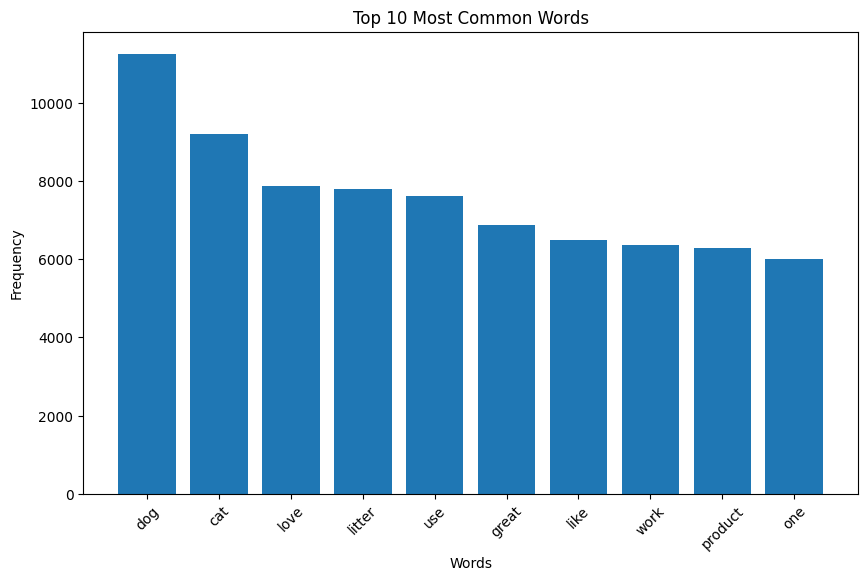

In [31]:
# Flatten the list of tokenized words
all_words = [word for tokens in stemmed_reviews for word in tokens]

# Create a frequency distribution of words
word_freq = Counter(all_words)

# Visualize the most frequent words
most_common_words = word_freq.most_common(10)

# Plotting the bar chart
plt.figure(figsize=(10, 6))
plt.bar([word[0] for word in most_common_words], [word[1] for word in most_common_words])
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Top 10 Most Common Words')
plt.xticks(rotation=45)
plt.show()

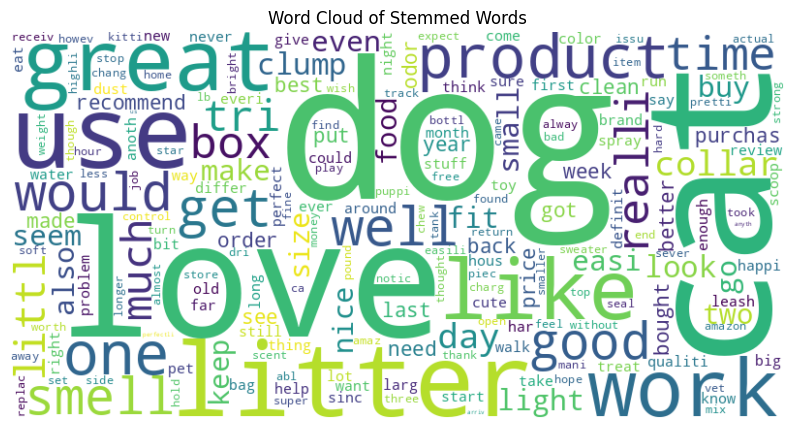

In [32]:
# Generate a word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Stemmed Words')
plt.show()

In [33]:
# Perform Sentiment Analysis using VADER
analyzer = SentimentIntensityAnalyzer()

# Function to calculate sentiment scores for each review
def get_sentiment_score(text):
    return analyzer.polarity_scores(text)['compound']

# Apply the sentiment analysis function to each review
sentiment_scores = clean_reviews.apply(get_sentiment_score)

# Add the sentiment scores as a new column in the DataFrame
reviews_with_sentiment = pd.concat([clean_reviews, sentiment_scores.rename('sentiment_score')], axis=1)

reviews_with_sentiment

,reviewText,sentiment_score
0,it fits my daughter as a royal princess; absol...,0.6115
1,my baby loved this dress. wore it for a weddi...,0.9531
2,now i must admit i am very hesitant on purchas...,0.9716
3,bought this for my daughter. fit was wonderful...,0.8548
4,it was even prettier than expected. i was more...,0.9096
...,...,...
30786,smaller than i thought,0.0000
30787,way too small for water for any more than a bi...,0.0000
30788,it rusted terrible will not buy again,-0.4767
30789,these work great for feeding my chickens their...,0.8910


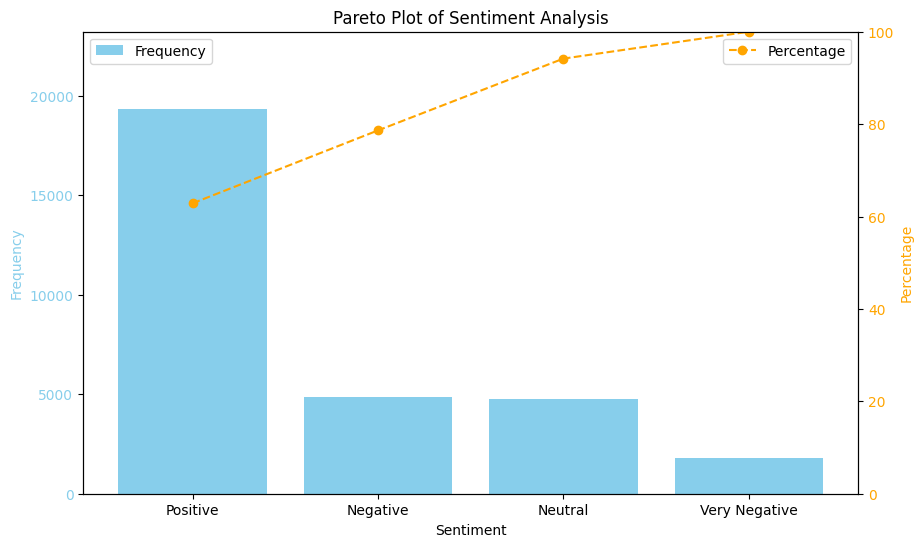

In [34]:
# Divide sentiment scores into four bins and count occurrences in each bin
bins = [-1, -0.5, 0, 0.5, 1]
bin_labels = ['Very Negative', 'Negative', 'Neutral', 'Positive']
reviews_with_sentiment['sentiment_bin'] = pd.cut(reviews_with_sentiment['sentiment_score'], bins=bins, labels=bin_labels)
sentiment_counts = reviews_with_sentiment['sentiment_bin'].value_counts()

# Sort the sentiment counts in descending order
sentiment_counts_sorted = sentiment_counts.sort_values(ascending=False)

# Calculate the cumulative percentage
cumulative_percentage = (sentiment_counts_sorted.cumsum() / sentiment_counts_sorted.sum()) * 100

# Create the Pareto plot with two y-axes
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot the bars on the left y-axis
ax1.bar(sentiment_counts_sorted.index, sentiment_counts_sorted, color='skyblue')
ax1.set_xlabel('Sentiment')
ax1.set_ylabel('Frequency', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')

# Create the right y-axis for the line plot
ax2 = ax1.twinx()

# Plot the cumulative percentage line on the right y-axis
ax2.plot(sentiment_counts_sorted.index, cumulative_percentage, color='orange', marker='o', linestyle='--')
ax2.set_ylabel('Percentage', color='orange')
ax2.tick_params(axis='y', labelcolor='orange')

# Set y-axis limits for both y-axes
ax1.set_ylim(0, sentiment_counts_sorted.max() * 1.2)  # Adjust the maximum limit for the left y-axis
ax2.set_ylim(0, 100)

# Add a legend for the line plot
ax1.legend(['Frequency'], loc='upper left')
ax2.legend(['Percentage'], loc='upper right')

plt.title('Pareto Plot of Sentiment Analysis')
plt.xticks(rotation=45)
plt.show()

In [35]:
# Create a dictionary from the tokenized reviews
dictionary = corpora.Dictionary(stemmed_reviews)

# Create a bag of words (BoW) representation of the reviews
corpus = [dictionary.doc2bow(tokens) for tokens in stemmed_reviews]

# Define the number of topics
num_topics = 5

# Build the LDA model
lda_model = models.LdaModel(corpus, num_topics=num_topics, id2word=dictionary)

# Print the topics and their top words
for idx, topic in lda_model.print_topics():
    print(f'Topic {idx+1}: {topic}\n')

# Get the dominant topic for each review
dominant_topics = [lda_model[doc][0][0] for doc in corpus]

# Add the dominant topic as a new column in the DataFrame
reviews_with_sentiment['dominant_topic'] = dominant_topics

# Display the DataFrame with dominant topics
print(reviews_with_sentiment)

Topic 1: 0.013*"dog" + 0.010*"get" + 0.010*"would" + 0.010*"use" + 0.009*"product" + 0.007*"see" + 0.007*"feeder" + 0.007*"pool" + 0.007*"put" + 0.006*"littl"

Topic 2: 0.041*"dog" + 0.029*"collar" + 0.015*"one" + 0.014*"like" + 0.012*"work" + 0.012*"love" + 0.009*"use" + 0.009*"would" + 0.009*"last" + 0.008*"night"

Topic 3: 0.072*"great" + 0.042*"work" + 0.039*"love" + 0.031*"good" + 0.025*"product" + 0.020*"qualiti" + 0.019*"look" + 0.018*"well" + 0.017*"nice" + 0.015*"price"

Topic 4: 0.030*"litter" + 0.025*"use" + 0.017*"one" + 0.012*"well" + 0.011*"work" + 0.009*"easi" + 0.009*"charg" + 0.007*"umbrella" + 0.007*"would" + 0.007*"box"

Topic 5: 0.052*"cat" + 0.019*"smell" + 0.017*"like" + 0.016*"clump" + 0.016*"use" + 0.013*"box" + 0.012*"tri" + 0.012*"spray" + 0.009*"work" + 0.008*"one"

                                              reviewText  sentiment_score  \
0      it fits my daughter as a royal princess; absol...           0.6115   
1      my baby loved this dress. wore it f

In [53]:
# Function to calculate PMI
def calculate_pmi(word_pairs_count, word_count, total_words):
    pmi_scores = {}
    for word_pair, count in word_pairs_count.items():
        word1, word2 = word_pair
        pmi = np.log2((count * total_words) / (word_count[word1] * word_count[word2]))
        pmi_scores[word_pair] = pmi
    return pmi_scores

# Function to build word co-occurrence matrix and calculate PMI scores
def calculate_word_associations(reviews, window_size=2):
    word_pairs_count = defaultdict(int)
    word_count = defaultdict(int)
    total_words = 0

    for review in reviews:
        total_words += len(review)
        for i in range(len(review)):
            word_count[review[i]] += 1
            for j in range(i+1, min(i+window_size, len(review))):
                word_pairs_count[(review[i], review[j])] += 1
                word_pairs_count[(review[j], review[i])] += 1

    pmi_scores = calculate_pmi(word_pairs_count, word_count, total_words)
    return pmi_scores

# Get the PMI scores for word associations
pmi_scores = calculate_word_associations(stemmed_reviews)

# Sort and print the top associated words for each word in the dataset
for word, scores in sorted(pmi_scores.items(), key=lambda x: x[1], reverse=True):
    associated_word, score = word, scores
    print(f"{word}: {score}")

('sqeek', 'purchasef'): 19.269160930328148
('purchasef', 'sqeek'): 19.269160930328148
('verizon', 'fio'): 19.269160930328148
('fio', 'verizon'): 19.269160930328148
('megapixel', 'pixel'): 19.269160930328148
('pixel', 'megapixel'): 19.269160930328148
('westley', 'buttercup'): 19.269160930328148
('buttercup', 'westley'): 19.269160930328148
('arch', 'walley'): 19.269160930328148
('walley', 'arch'): 19.269160930328148
('kimberlyann', 'daytodayimport'): 19.269160930328148
('daytodayimport', 'kimberlyann'): 19.269160930328148
('spongiform', 'encephalopathi'): 19.269160930328148
('encephalopathi', 'spongiform'): 19.269160930328148
('versian', 'mali'): 19.269160930328148
('mali', 'versian'): 19.269160930328148
('mali', 'uromastyx'): 19.269160930328148
('uromastyx', 'mali'): 19.269160930328148
('tastiest', 'wondrou'): 19.269160930328148
('wondrou', 'tastiest'): 19.269160930328148
('brutu', 'penelop'): 19.269160930328148
('penelop', 'brutu'): 19.269160930328148
('enviromwnt', 'dia'): 19.26916093

merge sentiments with reviews

In [62]:
dfAll.shape, reviews_with_sentiment.shape

((30791, 16), (30791, 4))

In [64]:
dfAll[["sentiment_score", "sentiment_bin"]] = reviews_with_sentiment[["sentiment_score", "sentiment_bin"]]
dfAll

,asin,overall,reviewText,reviewerID,summary,verified,also_buy,also_view,brand,category,description,feature,main_cat,price,title,cleanReviewText,sentiment_score,sentiment_bin
0,B00FHCKIWQ,5,It fits my daughter as a royal princess; absol...,A1MI2XGVEWGN7W,Royal look,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,it fits my daughter as a royal princess; absol...,0.6115,Positive
1,B00FHCKIWQ,5,My baby loved this dress. Wore it for a weddi...,A24EGC2ORSXPST,My baby loved this dress,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,my baby loved this dress. wore it for a weddi...,0.9531,Positive
2,B00FHCKIWQ,5,Now I must admit I am very hesitant on purchas...,ATB6TEHIQUN5F,Perfect flower girl dress!,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,now i must admit i am very hesitant on purchas...,0.9716,Positive
3,B00FHCKIWQ,5,Bought this for my daughter. Fit was wonderful...,A1C1CHJ9FUKJ4V,Fit was wonderful. Quality was so much better ...,true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,bought this for my daughter. fit was wonderful...,0.8548,Positive
4,B00FHCKIWQ,5,It was even prettier than expected. I was more...,A2QBFYNI78AX22,Absolutely Adorable :),true,[],"[B078TFCZR9, B0191IVAX2, B01IK0UIPI, B076MP4PH...",Kid's Dream,"[Clothing, Shoes & Jewelry, Girls, Clothing, D...",[A classic fine quality lace tea-length party ...,[Fine Quality Lace overlay with colored underl...,"<img src=""https://images-na.ssl-images-amazon....",$20.98 - $120.00,Girl's Elegant Lace Tea Length Flower Girl Par...,it was even prettier than expected. i was more...,0.9096,Positive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30786,B00BHVICZG,4,smaller than I thought,A3AAKDVPOWQFMO,Four Stars,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na...",smaller than i thought,0.0000,Negative
30787,B00BHVICZG,4,Way too small for water for any more than a bi...,AHKNLRAR8FX2J,Perfect calcium cup,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na...",way too small for water for any more than a bi...,0.0000,Negative
30788,B00BHVICZG,1,it rusted terrible will not buy again,A7604PHY9RB95,One Star,true,[],[],Little Giant,"[Patio, Lawn & Garden, Farm & Ranch, Poultry C...",[Built-in hooks allow this waterer to hang off...,"[Reduces spillage and soiling of water, Gravit...",Amazon Home,$9.93,"LITTLE GIANT 167451 Hanging Waterer, 1Pint, Na...",it rusted terrible will not buy again,-0.4767,Negative
30789,B00BHV

Sentiment brand analysis: only for the 10 brands with most comments

In [87]:
# Assuming you have a DataFrame called df and the column name is 'column_name'
column_counts = dfAll['brand'].value_counts()
brands = list(column_counts.index[:50])
brands

['Arm & Hammer',
 'Blueberry Pet',
 'GoDoggie-GLOW',
 'Purina Tidy Cats',
 'Wahl',
 'TerraMax Pro',
 'Sun Joe',
 'Flexi',
 'OxGord',
 'Petseer',
 'Aquatic Arts',
 'Meow Mix',
 'Ceva',
 'MG Collection',
 'Vetoquinol',
 'Wild Harvest',
 'Old Mother Hubbard',
 'KONG',
 'Fitwarm',
 'uxcell',
 'Confidence',
 'IRIS USA, Inc.',
 'Tail Trends',
 "Stella & Chewy's",
 'California Umbrella',
 'Bonka Bird Toys',
 'PetFusion',
 'Planet Pleasures',
 'Blue Buffalo',
 'Aquatic Life',
 'Wahl Professional Animal',
 'CEVA Animal Health',
 'Dogtra',
 'Merial',
 'MVP K9 Supplements',
 'Little Giant',
 'Vet Organics',
 'Periodic Products',
 'Esky',
 'Songbird Essentials',
 'Ruffwear',
 "Pet 'n Shape",
 'Deluxe Naturals',
 'PETARMOR',
 'Buckley',
 'Rocco & Roxie Supply Co',
 'Orijen',
 'Kurgo',
 "Nature's Miracle",
 'Sofantex']

In [88]:
# Sort the Series in descending order
sorted_series = column_counts.sort_values(ascending=False)

# Calculate the cumulative percentage
cumulative_percentage = (sorted_series.cumsum() / sorted_series.sum()) * 100

cumulative_percentage[:50]

brand
Arm & Hammer                10.486831
Blueberry Pet               17.479134
GoDoggie-GLOW               23.640025
Purina Tidy Cats            28.709688
Wahl                        33.107077
TerraMax Pro                37.403787
Sun Joe                     39.540775
Flexi                       41.349745
OxGord                      43.002826
Petseer                     44.620181
Aquatic Arts                46.175831
Meow Mix                    47.630801
Ceva                        49.040304
Vetoquinol                  50.355623
MG Collection               51.670943
Wild Harvest                52.879088
Old Mother Hubbard          54.083986
KONG                        55.236920
Fitwarm                     56.344386
uxcell                      57.390146
IRIS USA, Inc.              58.367705
Confidence                  59.345263
Stella & Chewy's            60.313078
Tail Trends                 61.280894
California Umbrella         62.151278
Bonka Bird Toys             62.982690
PetFus

In [99]:
dfBrands = dfAll[dfAll["brand"].isin(brands)][["brand", "sentiment_score", "sentiment_bin"]]
dfBrands

,brand,sentiment_score,sentiment_bin
361,Deluxe Naturals,0.9291,Positive
362,Deluxe Naturals,0.0000,Negative
363,Deluxe Naturals,0.8862,Positive
364,Deluxe Naturals,0.6221,Positive
365,Deluxe Naturals,0.6114,Positive
...,...,...,...
30786,Little Giant,0.0000,Negative
30787,Little Giant,0.0000,Negative
30788,Little Giant,-0.4767,Negative
30789,Little Giant,0.8910,Positive


In [100]:
# Group by 'brand' and 'sentiment_bin', then count the occurrences
sentiment_counts = dfBrands.groupby(['brand', 'sentiment_bin']).size().reset_index(name='count')

# Calculate the total count for each brand
brand_totals = sentiment_counts.groupby('brand')['count'].sum().reset_index(name='total_count')

# Merge the sentiment_counts with brand_totals on 'brand'
sentiment_counts = sentiment_counts.merge(brand_totals, on='brand')

# Calculate the percentage for each sentiment_bin
sentiment_counts['percentage'] = (sentiment_counts['count'] / sentiment_counts['total_count']) * 100

print(sentiment_counts)

            brand  sentiment_bin  count  total_count  percentage
0    Aquatic Arts  Very Negative     39          479    8.141962
1    Aquatic Arts       Negative     40          479    8.350731
2    Aquatic Arts        Neutral     43          479    8.977035
3    Aquatic Arts       Positive    357          479   74.530271
4    Aquatic Life  Very Negative     13          222    5.855856
..            ...            ...    ...          ...         ...
195  Wild Harvest       Positive    194          372   52.150538
196        uxcell  Very Negative     17          322    5.279503
197        uxcell       Negative     39          322   12.111801
198        uxcell        Neutral     48          322   14.906832
199        uxcell       Positive    218          322   67.701863

[200 rows x 5 columns]


In [101]:
print(sentiment_counts[sentiment_counts["sentiment_bin"].isin(["Very Negative", "Negative"])])

                        brand  sentiment_bin  count  total_count  percentage
0                Aquatic Arts  Very Negative     39          479    8.141962
1                Aquatic Arts       Negative     40          479    8.350731
4                Aquatic Life  Very Negative     13          222    5.855856
5                Aquatic Life       Negative     21          222    9.459459
8                Arm & Hammer  Very Negative    217         3229    6.720347
..                        ...            ...    ...          ...         ...
189  Wahl Professional Animal       Negative     24          194   12.371134
192              Wild Harvest  Very Negative     35          372    9.408602
193              Wild Harvest       Negative     78          372   20.967742
196                    uxcell  Very Negative     17          322    5.279503
197                    uxcell       Negative     39          322   12.111801

[100 rows x 5 columns]


In [103]:
# Group by 'brand' and sum the 'percentage' column
brand_summed_percentage = sentiment_counts[sentiment_counts["sentiment_bin"].isin(["Very Negative", "Negative"])].groupby('brand')['percentage'].sum().reset_index(name='total_percentage')

print(brand_summed_percentage)

                       brand  total_percentage
0               Aquatic Arts         16.492693
1               Aquatic Life         15.315315
2               Arm & Hammer         20.099102
3               Blue Buffalo         19.026549
4              Blueberry Pet         19.554111
5            Bonka Bird Toys         12.890625
6                    Buckley         15.753425
7         CEVA Animal Health         44.067797
8        California Umbrella         23.134328
9                       Ceva         35.023041
10                Confidence          8.970100
11           Deluxe Naturals         26.797386
12                    Dogtra         21.264368
13                      Esky         54.938272
14                   Fitwarm          9.970674
15                     Flexi         17.953321
16             GoDoggie-GLOW         18.661044
17            IRIS USA, Inc.         16.279070
18                      KONG         30.704225
19                     Kurgo         32.167832
20           